### Import Libraries

Mengimpor berbagai library penting yang digunakan untuk pengolahan data, visualisasi, pemodelan machine learning, dan evaluasi performa model. Mulai dari pengambilan data dari Kaggle, manipulasi data dengan Pandas dan NumPy, visualisasi dengan Matplotlib dan Seaborn, hingga penggunaan algoritma klasifikasi dan metrik evaluasi dari scikit-learn.

In [58]:
import kagglehub
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline
import seaborn as sns
import shutil
import os
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score

### Load Dataset

#### Mengunduh dataset kanker payudara secara otomatis dari Kaggle menggunakan library kagglehub.

In [59]:
datakaggle = kagglehub.dataset_download("yasserh/breast-cancer-dataset")

print("Path to dataset files:", datakaggle)

Path to dataset files: /kaggle/input/breast-cancer-dataset


#### Membuat folder lokal bernama /content/breast-cancer-dataset jika belum ada, lalu menyalin seluruh isi dataset yang sudah diunduh dari source_dir (folder hasil download Kaggle) ke folder tersebut.

In [60]:
source_dir = datakaggle
databreast = '/content/breast-cancer-dataset'

if not os.path.exists(databreast):
    os.makedirs(databreast)

shutil.copytree(source_dir, databreast, dirs_exist_ok=True)

print(f"Dataset copied from {source_dir} to {databreast}")

Dataset copied from /kaggle/input/breast-cancer-dataset to /content/breast-cancer-dataset


#### Menggabungkan path folder dataset dengan nama file breast-cancer.csv untuk mendapatkan path lengkap file CSV, lalu membaca file tersebut ke dalam sebuah DataFrame menggunakan Pandas

In [61]:
csv_file_path = os.path.join(databreast, 'breast-cancer.csv')
df = pd.read_csv(csv_file_path)
df

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


### Exploratory Data Analysis

#### Deskripsi Variabel

##### Menampilkan ringkasan informasi dari dataset, seperti jumlah baris dan kolom, tipe data setiap kolom, jumlah nilai non-null, serta penggunaan memori.

In [62]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

Insight: Dataset terdiri dari 569 baris dan 32 kolom, dengan mayoritas fitur berupa data numerik (float64), satu kolom identifikasi (int64), dan satu kolom target kategori (object).

##### Menampilkan ringkasan statistik deskriptif dari semua kolom numerik dalam DataFrame

In [63]:
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


Insight: Fitur-fitur numerik dalam dataset memiliki rentang nilai dan variasi yang cukup besar, terutama pada fitur seperti area_mean dan radius_worst yang menunjukkan nilai maksimum jauh di atas kuartil ketiga, mengindikasikan adanya nilai ekstrim atau outlier yang penting untuk dianalisis lebih lanjut. Distribusi data secara umum cenderung simetris, namun beberapa fitur memiliki perbedaan signifikan antara mean dan median yang mengindikasikan skewness. Selain itu, tidak ada data yang hilang, sehingga statistik deskriptif ini menggambarkan kondisi data yang lengkap dan siap untuk tahap preprocessing

##### Menghitung dan menampilkan jumlah masing-masing kategori dalam kolom diagnosis

In [64]:
print(df['diagnosis'].value_counts())

diagnosis
B    357
M    212
Name: count, dtype: int64


Insight: Output menunjukkan bahwa dataset terdiri dari 357 sampel dengan diagnosis jinak (B) dan 212 sampel dengan diagnosis ganas (M). Hal ini mengindikasikan distribusi kelas yang tidak seimbang, di mana kelas jinak lebih dominan dibanding kelas ganas

#### Menangani Missing Values

In [65]:
missing_counts = df.isnull().sum()
print(missing_counts)

total_missing = df.isnull().sum().sum()
print(f"Total missing values in dataset: {total_missing}")

id                         0
diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64
Total missing values in dataset: 0


Insight: Output tersebut menunjukkan bahwa tidak ada nilai yang hilang (missing values) pada seluruh kolom dataset

#### Menangani Outliers

##### Mendeteksi outlier pada kolom **diagnosis**

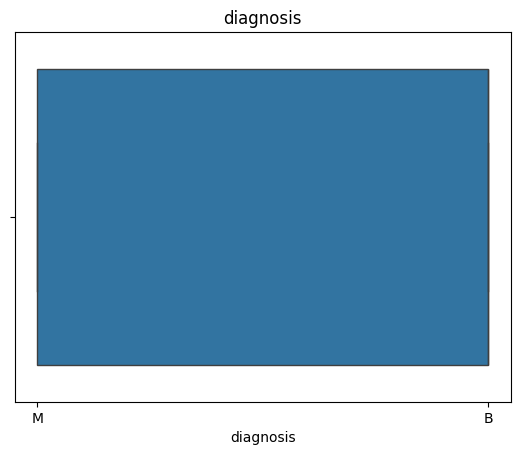

In [66]:
sns.boxplot(x=df['diagnosis'])
plt.title('diagnosis')
plt.show()

##### Mendeteksi outlier pada kolom **radius_mean**

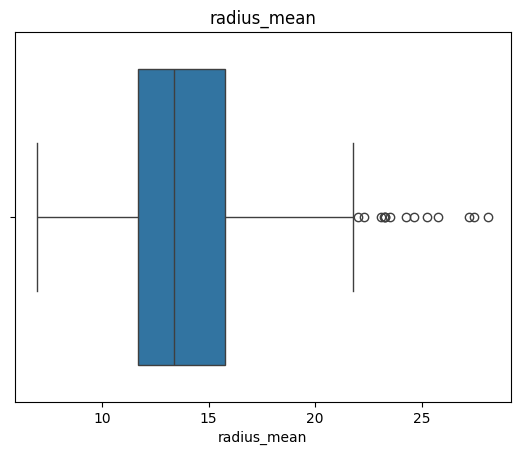

In [67]:
sns.boxplot(x=df['radius_mean'])
plt.title('radius_mean')
plt.show()

##### Mendeteksi outlier pada kolom **texture_mean**

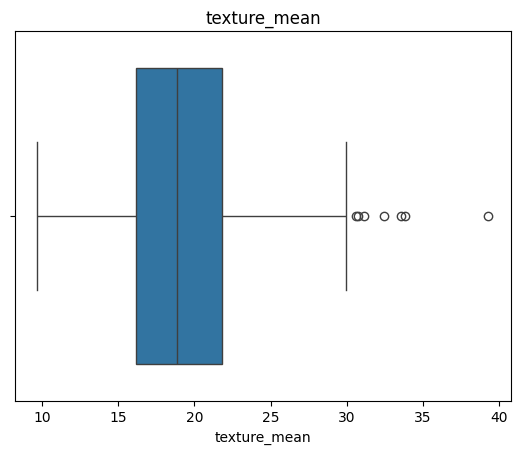

In [68]:
sns.boxplot(x=df['texture_mean'])
plt.title('texture_mean')
plt.show()

##### Mendeteksi outlier pada kolom **perimeter_mean**

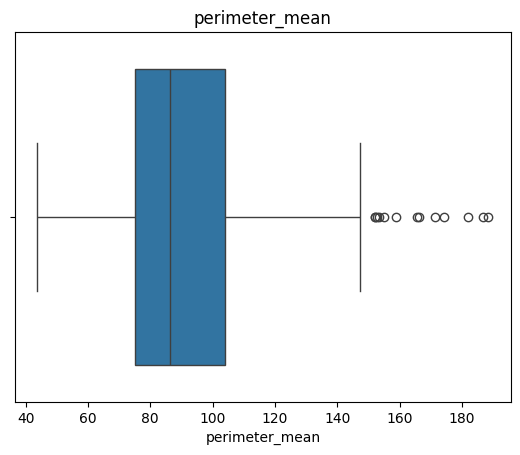

In [69]:
sns.boxplot(x=df['perimeter_mean'])
plt.title('perimeter_mean')
plt.show()

##### Mendeteksi outlier pada kolom **area_mean**

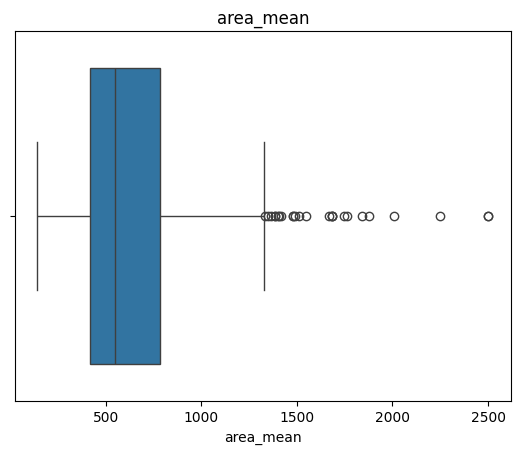

In [70]:
sns.boxplot(x=df['area_mean'])
plt.title('area_mean')
plt.show()

##### Mendeteksi outlier pada kolom **compactness_mean**

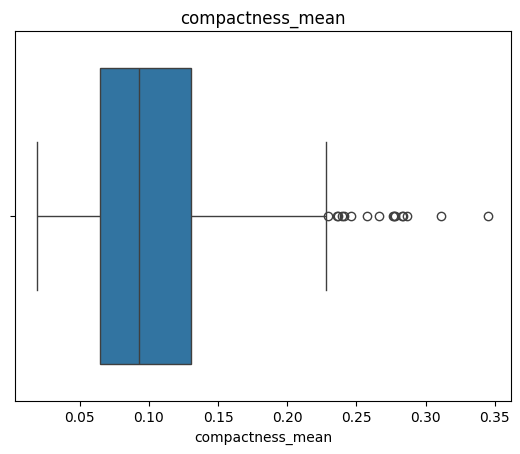

In [71]:
sns.boxplot(x=df['compactness_mean'])
plt.title('compactness_mean')
plt.show()

##### Mendeteksi outlier pada kolom **concavity_mean**

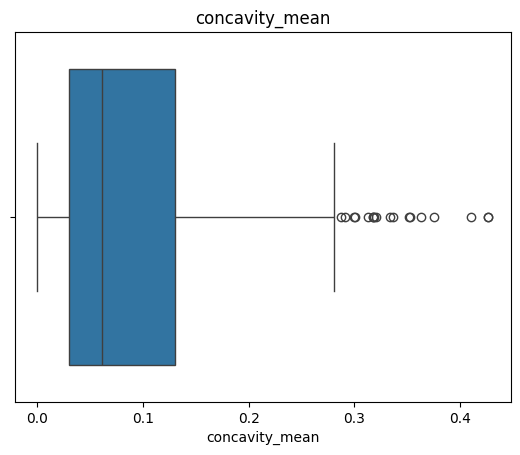

In [72]:
sns.boxplot(x=df['concavity_mean'])
plt.title('concavity_mean')
plt.show()

##### Mendeteksi outlier pada kolom **concave points_mean**

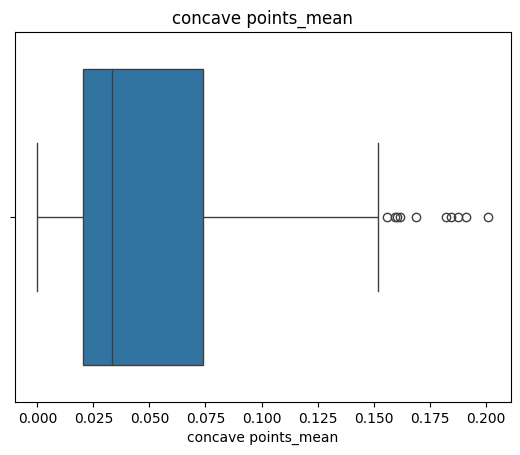

In [73]:
sns.boxplot(x=df['concave points_mean'])
plt.title('concave points_mean')
plt.show()

##### Mendeteksi outlier pada kolom **symmetry_mean**

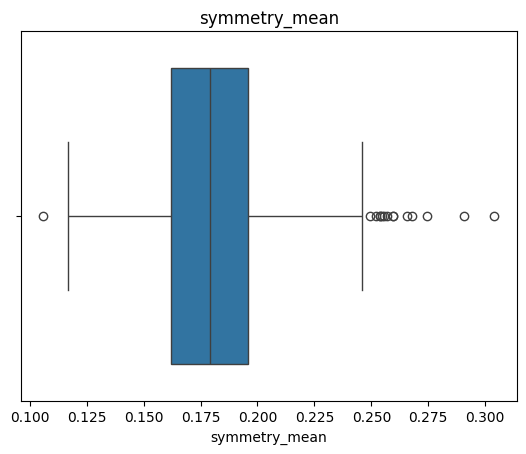

In [74]:
sns.boxplot(x=df['symmetry_mean'])
plt.title('symmetry_mean')
plt.show()

##### Mendeteksi outlier pada kolom **fractal_dimension_mean**

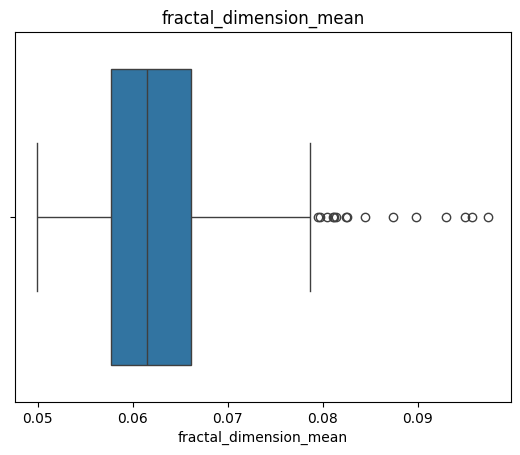

In [75]:
sns.boxplot(x=df['fractal_dimension_mean'])
plt.title('fractal_dimension_mean')
plt.show()

##### Mendeteksi outlier pada kolom **radius_se**

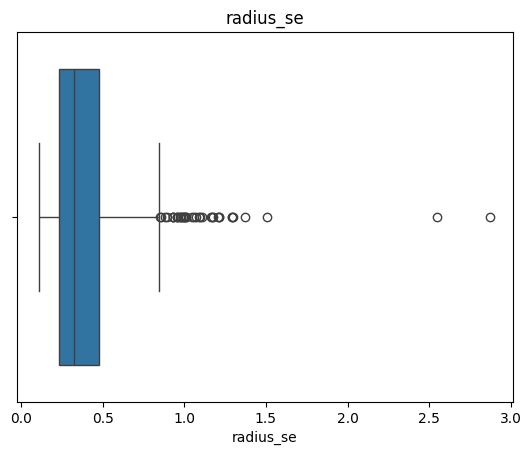

In [76]:
sns.boxplot(x=df['radius_se'])
plt.title('radius_se')
plt.show()

##### Mendeteksi outlier pada kolom **texture_se**

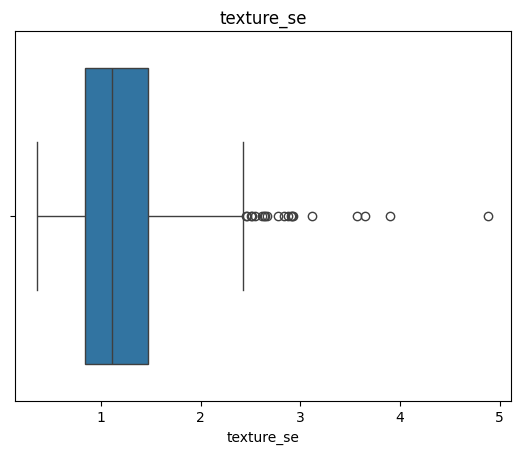

In [77]:
sns.boxplot(x=df['texture_se'])
plt.title('texture_se')
plt.show()

##### Mendeteksi outlier pada kolom **perimeter_se**

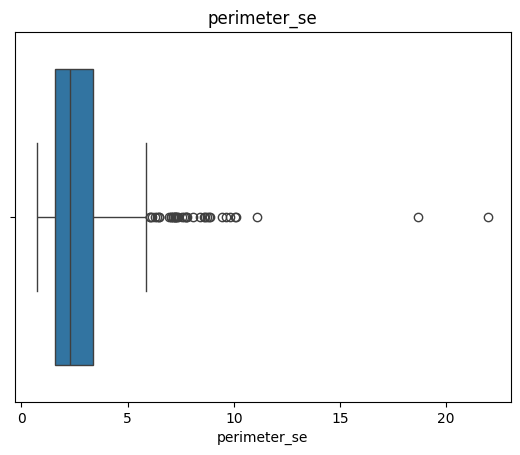

In [78]:
sns.boxplot(x=df['perimeter_se'])
plt.title('perimeter_se')
plt.show()

##### Mendeteksi outlier pada kolom **area_se**

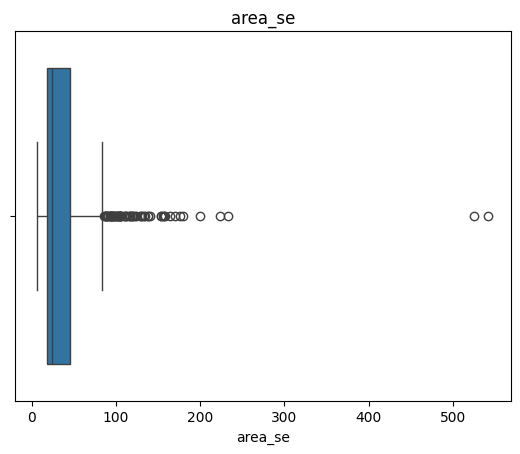

In [79]:
sns.boxplot(x=df['area_se'])
plt.title('area_se')
plt.show()

##### Mendeteksi outlier pada kolom **smoothness_se**

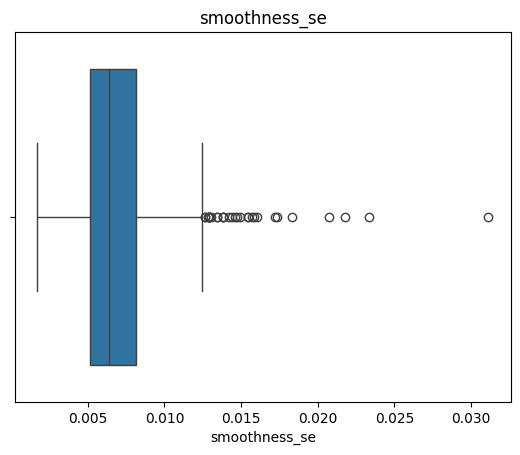

In [80]:
sns.boxplot(x=df['smoothness_se'])
plt.title('smoothness_se')
plt.show()

##### Mendeteksi outlier pada kolom **compactness_se**

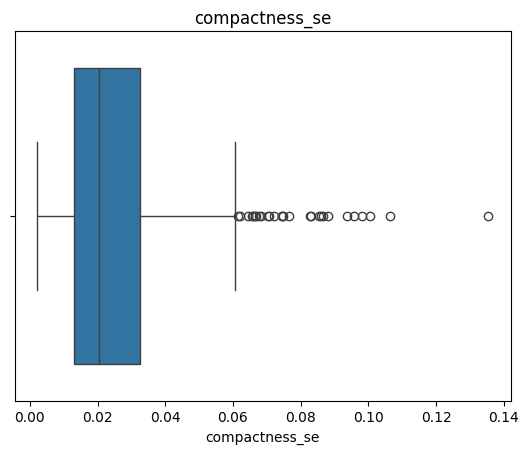

In [81]:
sns.boxplot(x=df['compactness_se'])
plt.title('compactness_se')
plt.show()

##### Mendeteksi outlier pada kolom **concavity_se**

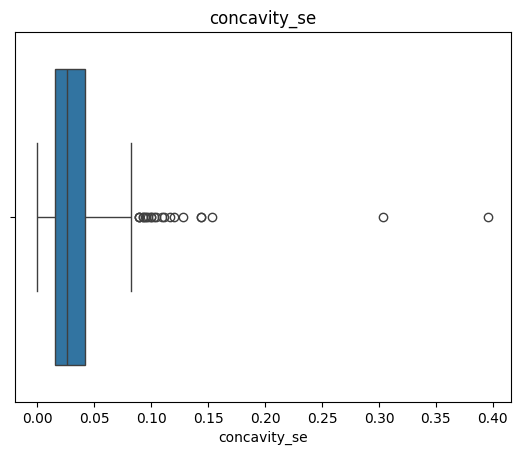

In [82]:
sns.boxplot(x=df['concavity_se'])
plt.title('concavity_se')
plt.show()

##### Mendeteksi outlier pada kolom **concave points_se**

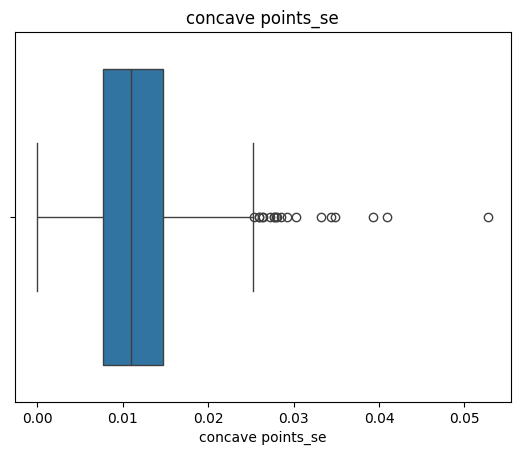

In [83]:
sns.boxplot(x=df['concave points_se'])
plt.title('concave points_se')
plt.show()

##### Mendeteksi outlier pada kolom **symmetry_se**

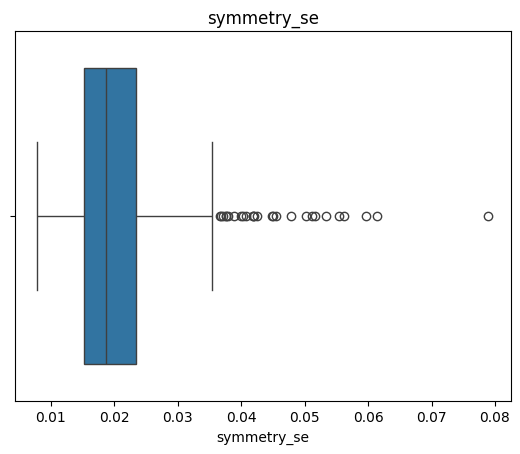

In [84]:
sns.boxplot(x=df['symmetry_se'])
plt.title('symmetry_se')
plt.show()

##### Mendeteksi outlier pada kolom **fractal_dimension_se**

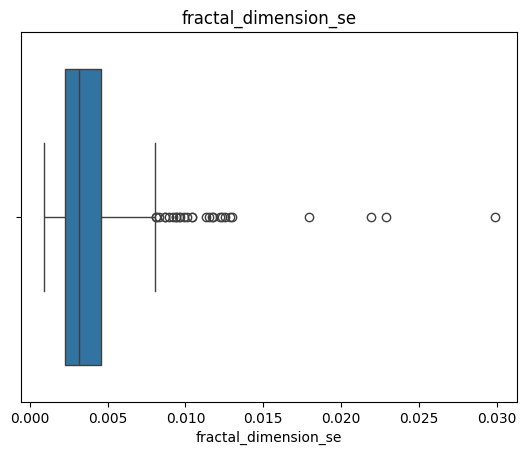

In [85]:
sns.boxplot(x=df['fractal_dimension_se'])
plt.title('fractal_dimension_se')
plt.show()

##### Mendeteksi outlier pada kolom **radius_worst**

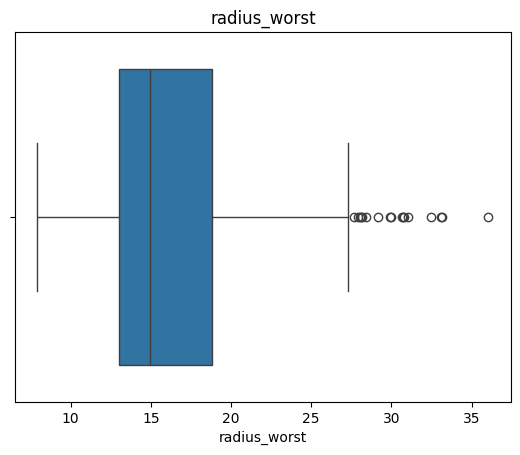

In [86]:
sns.boxplot(x=df['radius_worst'])
plt.title('radius_worst')
plt.show()

##### Mendeteksi outlier pada kolom **texture_worst**

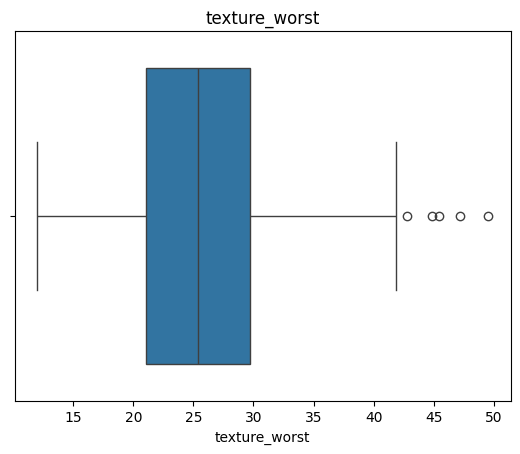

In [87]:
sns.boxplot(x=df['texture_worst'])
plt.title('texture_worst')
plt.show()

##### Mendeteksi outlier pada kolom **perimeter_worst**

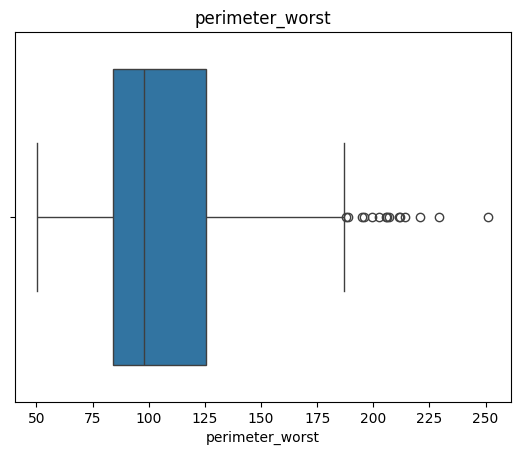

In [88]:
sns.boxplot(x=df['perimeter_worst'])
plt.title('perimeter_worst')
plt.show()

##### Mendeteksi outlier pada kolom **area_worst**

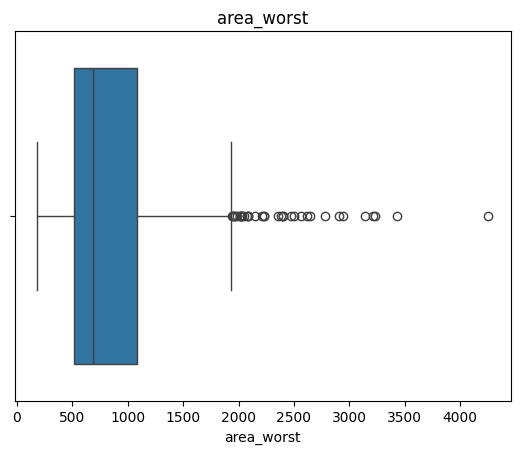

In [89]:
sns.boxplot(x=df['area_worst'])
plt.title('area_worst')
plt.show()

##### Mendeteksi outlier pada kolom **smoothness_worst**

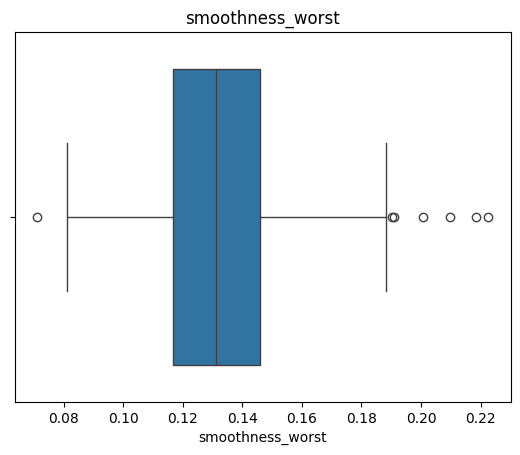

In [90]:
sns.boxplot(x=df['smoothness_worst'])
plt.title('smoothness_worst')
plt.show()

##### Mendeteksi outlier pada kolom **compactness_worst**

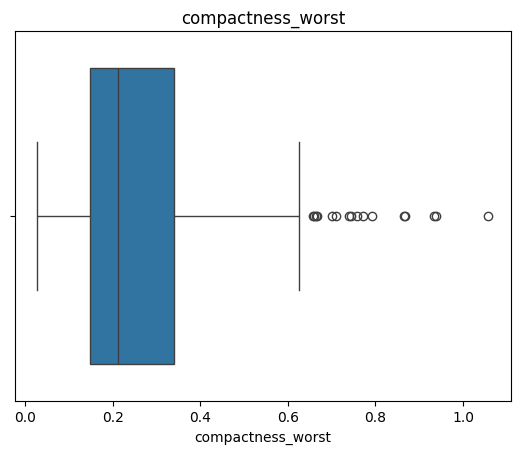

In [91]:
sns.boxplot(x=df['compactness_worst'])
plt.title('compactness_worst')
plt.show()

##### Mendeteksi outlier pada kolom **concavity_worst**

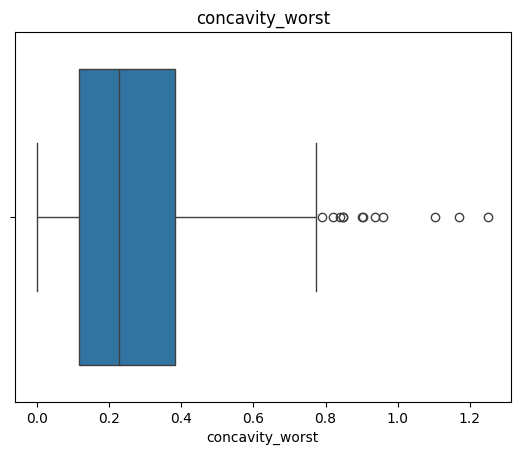

In [92]:
sns.boxplot(x=df['concavity_worst'])
plt.title('concavity_worst')
plt.show()

##### Mendeteksi outlier pada kolom **concave points_worst**

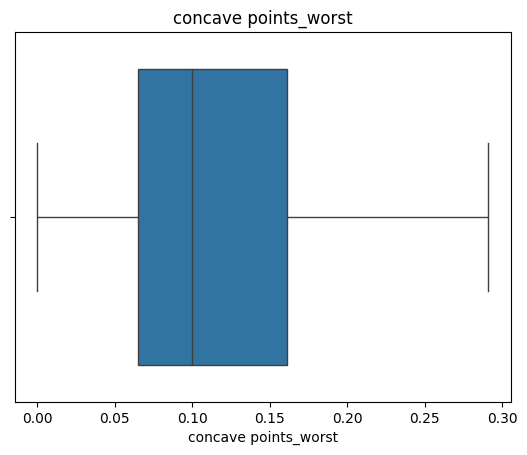

In [93]:
sns.boxplot(x=df['concave points_worst'])
plt.title('concave points_worst')
plt.show()

##### Mendeteksi outlier pada kolom **symmetry_worst**

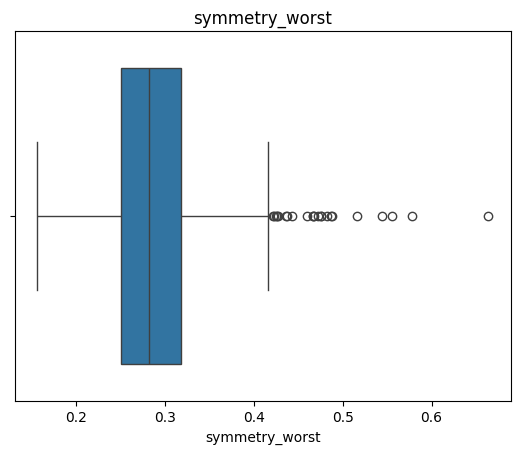

In [94]:
sns.boxplot(x=df['symmetry_worst'])
plt.title('symmetry_worst')
plt.show()

##### Mendeteksi outlier pada kolom **fractal_dimension_worst**

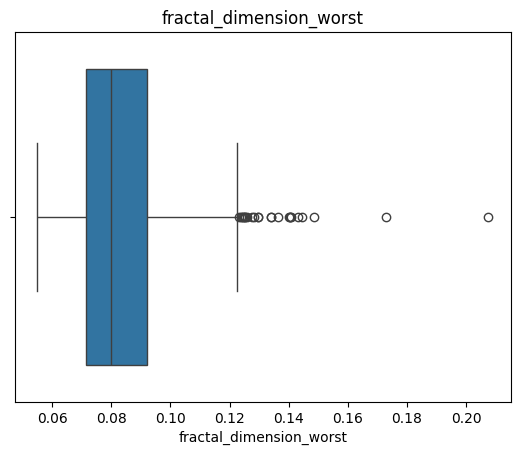

In [95]:
sns.boxplot(x=df['fractal_dimension_worst'])
plt.title('fractal_dimension_worst')
plt.show()

Insight: Meskipun outlier ditemukan pada beberapa variabel, data tersebut tidak dihapus atau dibersihkan karena dalam konteks data kesehatan, nilai ekstrim dapat mengandung informasi penting yang relevan untuk diagnosis penyakit

#### Univariate Analysis

##### Mengelompokkan fitur-fitur dalam dataset berdasarkan tipe datanya

In [96]:
numerical_features = df.select_dtypes(include=np.number).columns.tolist()
numerical_features.remove('id')

categorical_features = df.select_dtypes(exclude=np.number).columns.tolist()

print("Numerical features:", numerical_features)
print("Categorical features:", categorical_features)

Numerical features: ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']
Categorical features: ['diagnosis']


Insight: Dataset memiliki 30 fitur numerik yang beragam, seperti radius_mean, texture_mean, dan area_mean, yang menggambarkan berbagai karakteristik morfologi jaringan payudara, serta 1 fitur kategorikal yaitu diagnosis yang menjadi target klasifikasi dengan nilai kelas jinak atau ganas

##### Categorical Feature

Melakukan visualisasi distribusi data untuk setiap fitur kategorikal dalam dataset

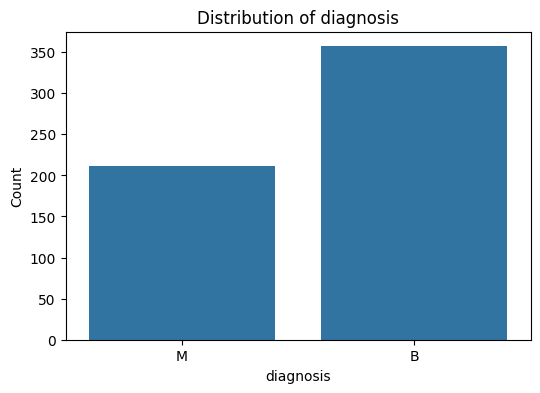

In [97]:
for feature in categorical_features:
    plt.figure(figsize=(6, 4))
    sns.countplot(x=df[feature])
    plt.title(f'Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Count')
    plt.show()

Insight: Visualisasi menunjukkan distribusi kelas pada variabel diagnosis, di mana jumlah sampel dengan diagnosis jinak (B) lebih banyak, yakni 357 data, dibandingkan dengan diagnosis ganas (M) sebanyak 212 data

##### Numerical Features

Membuat visualisasi distribusi masing-masing fitur numerik dalam dataset

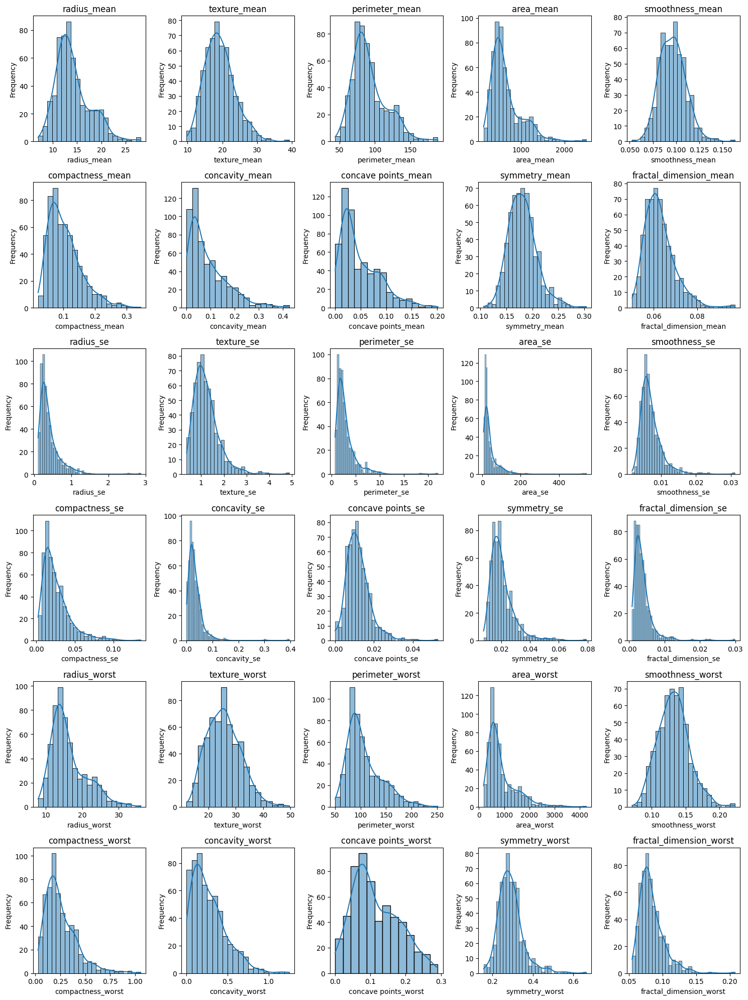

In [98]:
plt.figure(figsize=(15, 20))
for i, feature in enumerate(numerical_features):
    plt.subplot(6, 5, i + 1)
    sns.histplot(data=df, x=feature, kde=True)
    plt.title(f'{feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

Insight: Sebagian besar fitur memiliki distribusi yang cenderung miring ke kanan (positively skewed) dengan puncak yang jelas, menunjukkan bahwa sebagian besar sampel memiliki nilai fitur dalam rentang rendah hingga menengah, sedangkan nilai tinggi relatif jarang dan bisa jadi berperan sebagai outlier

#### Multivariate Analysis

##### Membuat visualisasi pairplot untuk semua fitur numerik dalam dataset dengan pewarnaan berdasarkan kelas diagnosis

In [99]:
sns.pairplot(df, vars=numerical_features, hue='diagnosis', palette='viridis')
plt.suptitle('Pairplot of Numerical Features by Diagnosis', y=1.02)
plt.show()

Insight: Pairplot menunjukkan bahwa beberapa pasangan fitur numerik mampu memisahkan secara visual antara data dengan diagnosis jinak (B) dan ganas (M), yang diwakili oleh dua warna berbeda. Sebaran data membentuk pola klaster yang cukup jelas pada kombinasi fitur tertentu

##### Memvisualisasikan rata-rata nilai setiap fitur numerik berdasarkan kategori diagnosis

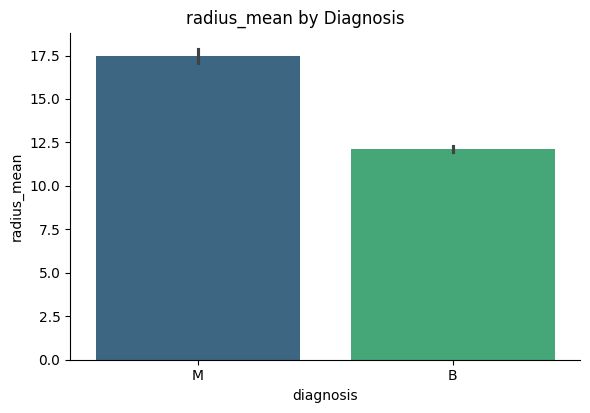

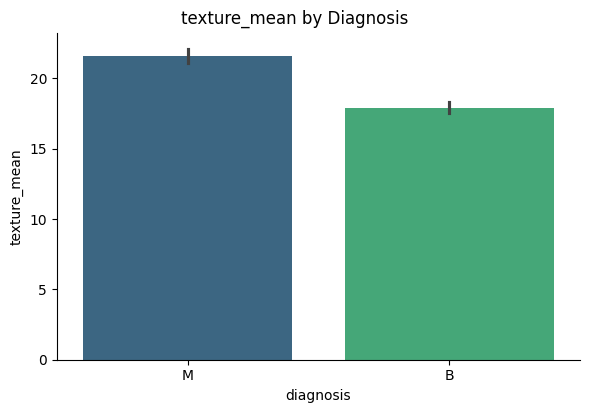

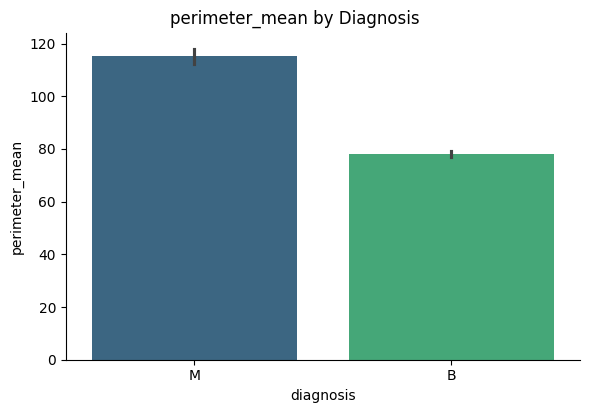

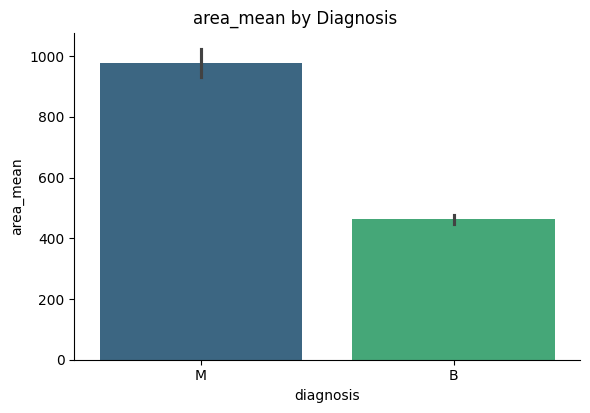

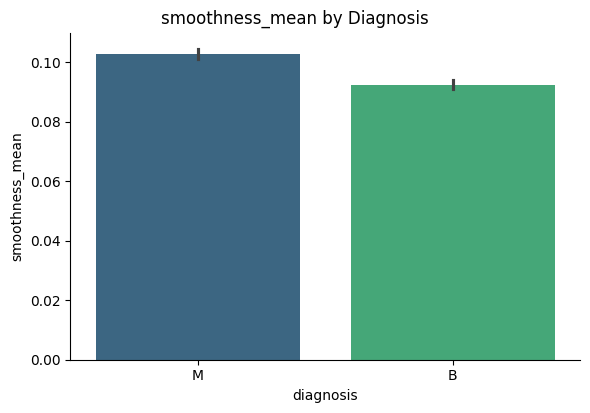

...

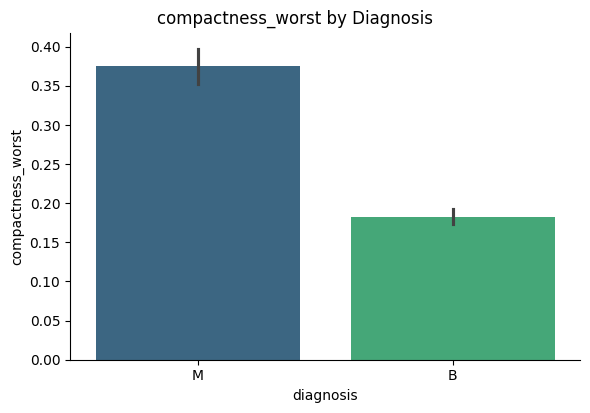

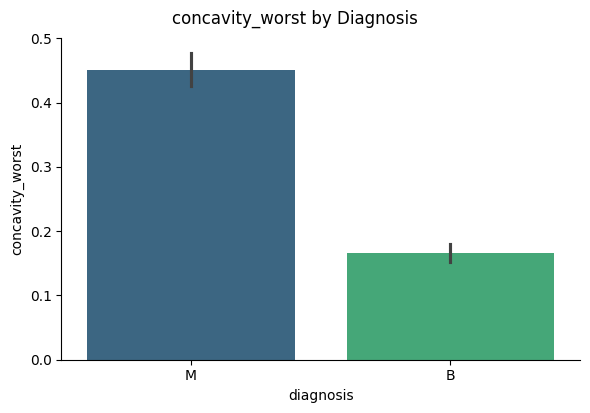

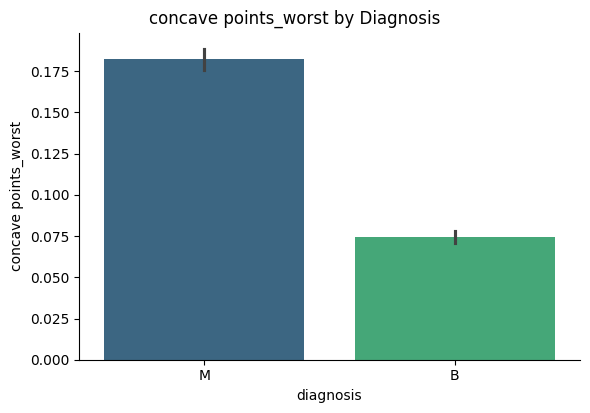

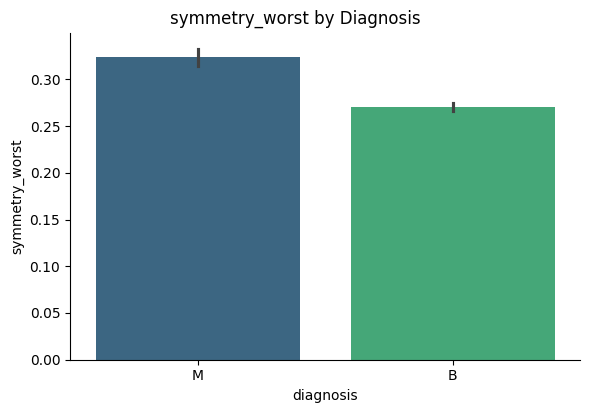

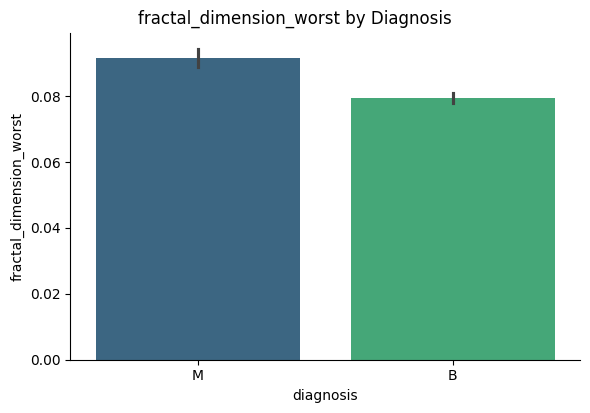

In [100]:
for feature in numerical_features:
    sns.catplot(x='diagnosis', y=feature, data=df, kind='bar', hue='diagnosis', palette='viridis', height=4, aspect=1.5)
    plt.suptitle(f'{feature} by Diagnosis', y=1.02)
    plt.show()

Insight: Visualisasi bar plot menunjukkan bahwa nilai rata-rata pada fitur numerik seperti radius_mean dan texture_mean cenderung lebih tinggi pada pasien dengan diagnosis ganas (M) dibandingkan dengan yang jinak (B). Pola ini menegaskan bahwa beberapa fitur numerik memiliki perbedaan yang signifikan antara kedua kelas diagnosis, sehingga berpotensi menjadi indikator penting dalam proses klasifikasi

##### Menghitung dan memvisualisasikan korelasi antar fitur numerik dalam dataset menggunakan heatmap

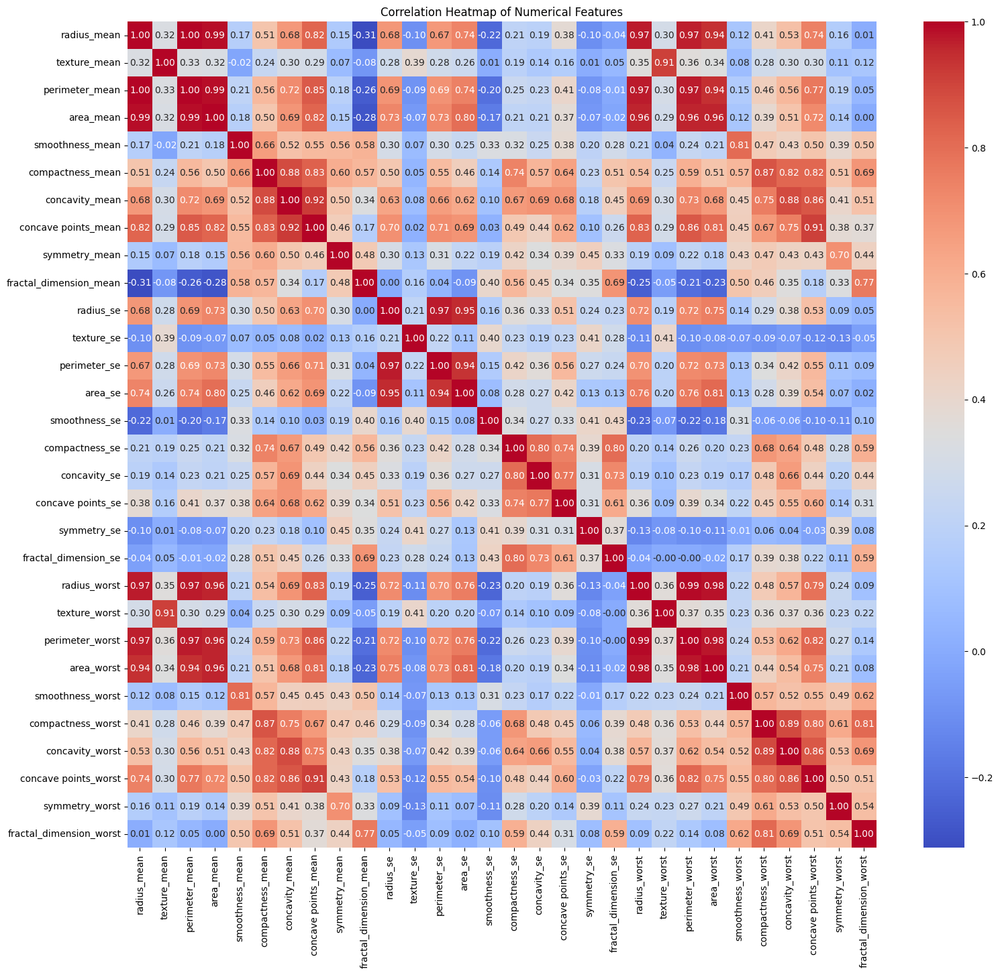

In [101]:
correlation_matrix = df[numerical_features].corr()

plt.figure(figsize=(18, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Features')
plt.show()

Insight: Beberapa fitur numerik memiliki korelasi yang sangat tinggi, seperti radius_mean, perimeter_mean, dan area_mean yang saling berkorelasi hampir sempurna (mendekati 1.00). Ini mengindikasikan adanya redundansi informasi antar fitur, yang bisa menyebabkan multikolinearitas dalam model dan dapat dipertimbangkan untuk reduksi dimensi dengan PCA

### Data Preparation

#### Encoding Fitur Kategorikal dengan One Hot Encoding

In [102]:
df_encoded = pd.get_dummies(df, columns=['diagnosis'], prefix='diagnosis')

display(df_encoded.head())

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,diagnosis_B,diagnosis_M
0,842302,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,False,True
1,842517,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,False,True
2,84300903,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,False,True
3,84348301,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,False,True
4,84358402,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,False,True


Insight: Fitur diagnosis telah berhasil diubah menjadi dua kolom dummy (diagnosis_B dan diagnosis_M) menggunakan teknik one-hot encoding

#### Standarisasi

##### Menghapus kolom id, diagnosis_B, dan diagnosis_M dari DataFrame yang telah diencoding

In [103]:
X = df_encoded.drop(columns=['id', 'diagnosis_B', 'diagnosis_M'])

##### Melakukan proses standarisasi terhadap fitur-fitur numerik dalam variabel X menggunakan StandardScaler dari scikit-learn

In [104]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

#### Reduksi Dimensi dengan PCA

##### Mereduksi dimensi data hasil standarisasi (X_scaled) menjadi hanya 2 komponen utama

In [105]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

##### Menampilkan proporsi variasi (informasi) dalam data asli yang berhasil dijelaskan oleh masing-masing komponen utama hasil PCA

In [106]:
print("Explained variance ratio per principal component:")
print(pca.explained_variance_ratio_)

Explained variance ratio per principal component:
[0.44272026 0.18971182]


##### Visualisasi dan evaluasi distribusi data dalam ruang dua dimensi yang telah direduksi

In [107]:
df_pca = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])
df_pca['diagnosis'] = df['diagnosis']

##### Membuat scatter plot dua dimensi dari hasil PCA menggunakan fitur PC1 dan PC2, dengan pewarnaan berdasarkan kategori diagnosis

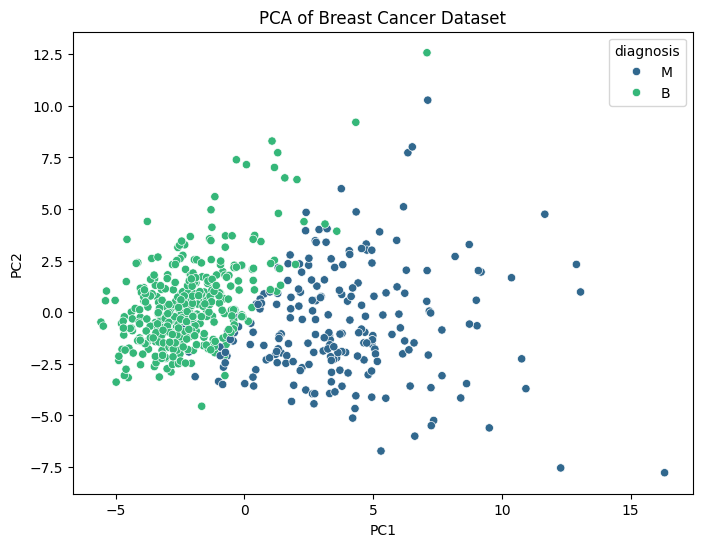

In [108]:
plt.figure(figsize=(8,6))
sns.scatterplot(x='PC1', y='PC2', hue='diagnosis', data=df_pca, palette='viridis')
plt.title('PCA of Breast Cancer Dataset')
plt.show()

### Train-Test Split

#### Mengubah label diagnosis menjadi format numerik, serta menetapkan data hasil PCA sebagai fitur input (X) untuk proses pelatihan model selanjutnya

In [109]:
le = LabelEncoder()
y = le.fit_transform(df['diagnosis'])

X = X_pca

#### Membagi data menjadi data latih dan data uji dengan proporsi 90% untuk pelatihan dan 10% untuk pengujian

In [110]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.1, random_state=42, stratify=y
)

### Model Development

#### Model Development dengan Logistic Regression

In [111]:
lr_model = LogisticRegression(max_iter=1000, random_state=42)
lr_model.fit(X_train, y_train)

y_pred_lr = lr_model.predict(X_test)

#### Model Development dengan Random Forest

In [112]:
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

y_pred_rf = rf_model.predict(X_test)

#### Model Development dengan Support Vector Machine

In [113]:
svm_model = SVC(kernel='rbf', probability=True, random_state=42)
svm_model.fit(X_train, y_train)

y_pred_svm = svm_model.predict(X_test)

### Evaluasi Model

#### Evaluasi Model Logistic Regression

In [114]:
print("Logistic Regression Results:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_lr):.4f}")
print("Classification Report:")
print(classification_report(y_test, y_pred_lr, target_names=le.classes_))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_lr))

Logistic Regression Results:
Accuracy: 1.0000
Classification Report:
              precision    recall  f1-score   support

           B       1.00      1.00      1.00        36
           M       1.00      1.00      1.00        21

    accuracy                           1.00        57
   macro avg       1.00      1.00      1.00        57
weighted avg       1.00      1.00      1.00        57

Confusion Matrix:
[[36  0]
 [ 0 21]]


Insight: Hasil evaluasi model Logistic Regression menunjukkan performa sempurna dengan akurasi, precision, recall, dan F1-score semuanya bernilai 1.00 untuk kedua kelas

#### Evaluasi Model Random Forest

In [115]:
print("Random Forest Results:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")
print("Classification Report:")
print(classification_report(y_test, y_pred_rf, target_names=le.classes_))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_rf))

Random Forest Results:
Accuracy: 1.0000
Classification Report:
              precision    recall  f1-score   support

           B       1.00      1.00      1.00        36
           M       1.00      1.00      1.00        21

    accuracy                           1.00        57
   macro avg       1.00      1.00      1.00        57
weighted avg       1.00      1.00      1.00        57

Confusion Matrix:
[[36  0]
 [ 0 21]]


Insight: Hasil evaluasi model Random Forest menunjukkan performa yang sangat baik dengan akurasi, precision, recall, dan F1-score sempurna (1.00) untuk kedua kelas diagnosis

#### Evaluasi Model Support Vector machine (SVM)

In [116]:
print("SVM Results:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")
print("Classification Report:")
print(classification_report(y_test, y_pred_svm, target_names=le.classes_))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_svm))

SVM Results:
Accuracy: 0.9474
Classification Report:
              precision    recall  f1-score   support

           B       0.92      1.00      0.96        36
           M       1.00      0.86      0.92        21

    accuracy                           0.95        57
   macro avg       0.96      0.93      0.94        57
weighted avg       0.95      0.95      0.95        57

Confusion Matrix:
[[36  0]
 [ 3 18]]


Insight: Model SVM (Support Vector Machine) menghasilkan akurasi sebesar 94,74% dengan precision 1.00 dan recall 0.86 untuk kelas ganas (M), serta precision 0.92 dan recall 1.00 untuk kelas jinak (B)

#### Membandingkan performa tiga model klasifikasi — Logistic Regression, Random Forest, dan SVM

In [117]:
metrics = []

models_preds = {
    'Logistic Regression': y_pred_lr,
    'Random Forest': y_pred_rf,
    'SVM': y_pred_svm
}

for model_name, y_pred in models_preds.items():
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    metrics.append({
        'Model': model_name,
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F1-Score': f1
    })

df_metrics = pd.DataFrame(metrics)

print("Evaluation Metrics Comparison:")
print(df_metrics)

Evaluation Metrics Comparison:
                 Model  Accuracy  Precision    Recall  F1-Score
0  Logistic Regression  1.000000        1.0  1.000000  1.000000
1        Random Forest  1.000000        1.0  1.000000  1.000000
2                  SVM  0.947368        1.0  0.857143  0.923077


Insight: Hasil perbandingan metrik evaluasi menunjukkan bahwa model Logistic Regression dan Random Forest memiliki performa sempurna pada seluruh metrik (akurasi, precision, recall, dan F1-score) dengan nilai 1.0, menandakan kemampuan luar biasa dalam mengklasifikasikan data tanpa kesalahan pada data uji. Sementara itu, model SVM mencatat akurasi sebesar 94,74% dengan precision tetap sempurna (1.0), namun recall menurun menjadi 0.857143 yang menyebabkan nilai F1-score juga turun menjadi 0.923077. Ini menunjukkan bahwa meskipun SVM cukup akurat secara keseluruhan, model ini masih menghasilkan beberapa false negative, menjadikannya kurang ideal dalam konteks diagnosis medis. Berdasarkan hasil evaluasi tersebut, Random Forest dipilih sebagai model terbaik karena selain mencapai performa yang sangat tinggi dan seimbang di semua metrik, model ini juga memiliki keunggulan dalam menangani data non-linear dan bersifat lebih robust terhadap noise dan overfitting dibandingkan Logistic Regression, menjadikannya lebih andal untuk diterapkan dalam skenario dunia nyata